## Classes

In [2]:
import typing

class DisasterInstanceFileName:
    """
        Clase que representa el sistema de nomenclatura de archivos 
        relacionados a un evento que contiene el dataset xBD.
    """
    locationName : str;
    disasterType : str;
    id : str;
    prefix : str;

    def __init__(self,file_name :str):
        parts : typing.List[str] = file_name.split('_');
        name = parts[0].split('-')
        self.locationName = name[0];
        self.disasterType = name[1];
        self.id = parts[1];
        self.prefix = parts[2];

    def get_prefix(self)->str:
        return self.prefix
    
    def get_disaster_instance_id(self) -> str:
        return f'{self.locationName}-{self.disasterType}_{self.id}'    
    def get_image_file_name(self) -> str:
        return f'{self.locationName}-{self.disasterType}_{self.id}_{self.prefix}_disaster.png'
    def get_json_file_name(self) -> str:
        return f'{self.locationName}-{self.disasterType}_{self.id}_{self.prefix}_disaster.json'
    def get_target_file_name(self) -> str:
        return f'{self.locationName}-{self.disasterType}_{self.id}_{self.prefix}_disaster_target.png'
    
class DisasterPair:
    """
        Clase que representa el par de Instancias pre y post desastre
    """
    pre_disaster : DisasterInstanceFileName = None;
    post_disaster : DisasterInstanceFileName = None;
    
    def set_pre(self,instance : DisasterInstanceFileName):
        self.pre_disaster = instance;
    def set_post(self,instance : DisasterInstanceFileName):
        self.post_disaster = instance;

    def get_pre(self) -> DisasterInstanceFileName:
        return self.pre_disaster;
    def get_post(self) -> DisasterInstanceFileName:
        return self.post_disaster;


## Algorithm

In [3]:
import os

# Rutas a las imágenes y los archivos JSON de anotaciones
image_dir = '../data/my_train/images'
label_dir = '../data/my_train/labels'
target_dir = '../data/my_train/targets'

image_files = os.listdir(image_dir)

disaster_pair_dicc = {}
for fileName in image_files:
    instance = DisasterInstanceFileName(fileName);
    instance_id : str = instance.get_disaster_instance_id();
    
    curr_disaster_pair : DisasterPair = disaster_pair_dicc.get(instance_id,None)

    if(curr_disaster_pair == None):
        curr_disaster_pair = DisasterPair();
    
    if(instance.get_prefix() == "pre"):
        curr_disaster_pair.set_pre(instance);
    else:
        curr_disaster_pair.set_post(instance);
    disaster_pair_dicc[instance_id] = curr_disaster_pair

    

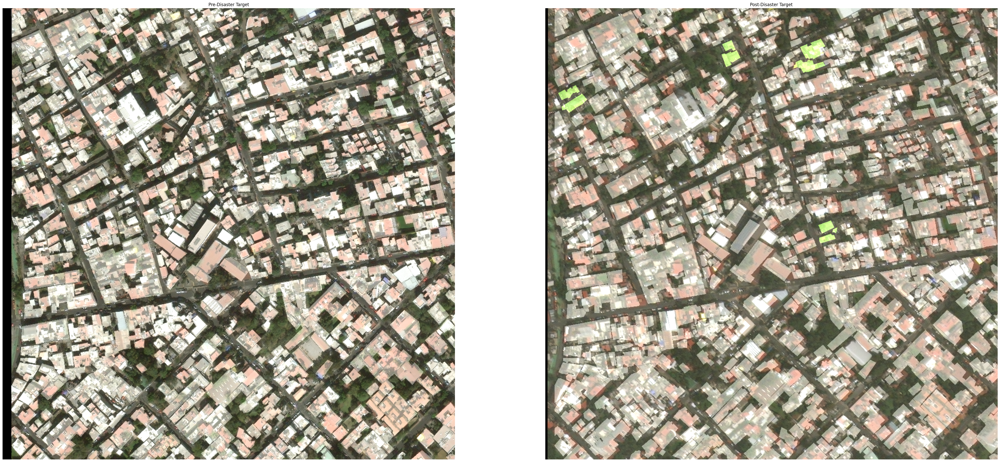

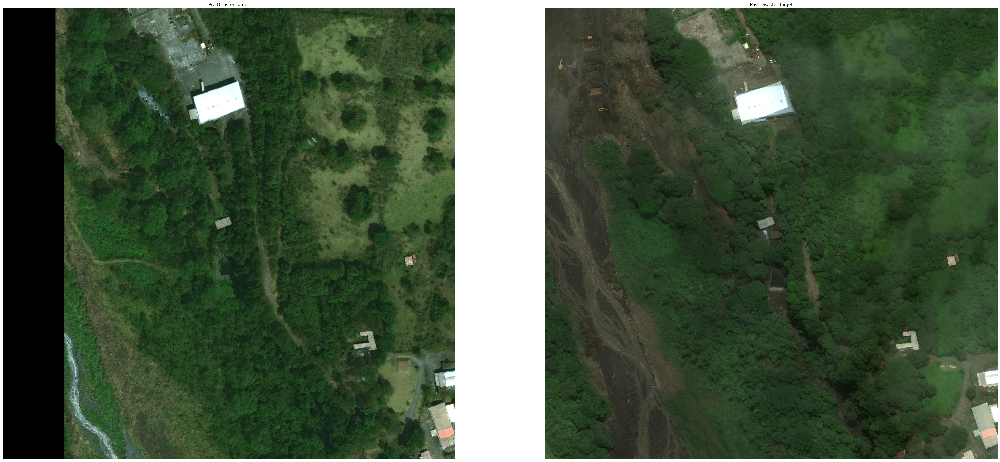

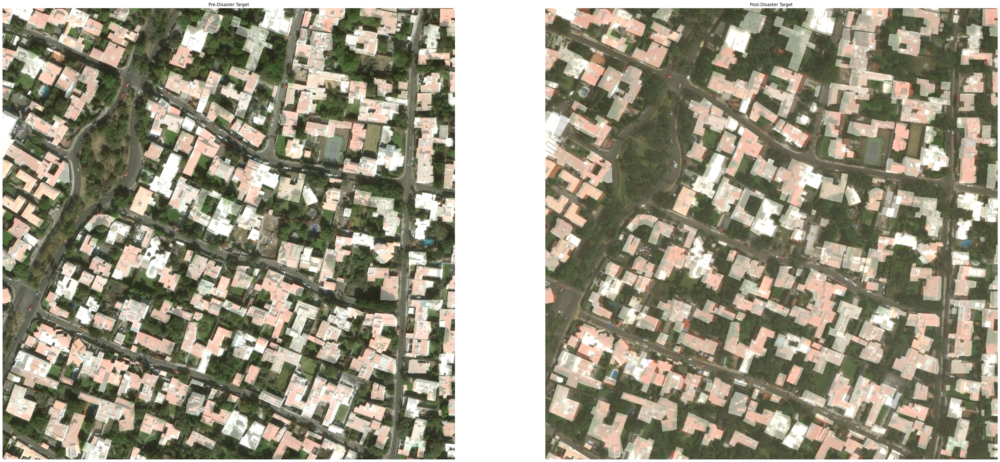

In [4]:
import cv2
import json
import matplotlib.pyplot as plt
import numpy as np

def supp(img,target):
    img_disaster = cv2.cvtColor(img,cv2.COLOR_RGB2BGR)    
    target[target[:,:,0] == 1] = [150,150,150]
    target[target[:,:,0] == 2] = [178,255,102]
    target[target[:,:,0] == 3] = [194,255,94]
    target[target[:,:,0] == 4] = [255,139,51]
    target[target[:,:,0] == 5] = [255,19,19]
    #BGR
        #target_disaster = cv2.applyColorMap(amplified_target_alpha, cv2.COLORMAP_JET)
    #print(np.unique(target, return_index=False, return_inverse=False, return_counts=False, axis=None))
    
    alpha = 0.6 # Ajustar la transparencia de la segunda imagen
    superposed_image = cv2.addWeighted(img_disaster, 1, target, alpha, 0)
    return superposed_image

def showImage(img_pre,img_post,target_pre,target_post):
    target_pre_img = supp(img_pre,target_pre)
    target_post_img = supp(img_post,target_post)
    # Mostrar las imágenes
    plt.figure(figsize=(50, 50))

    plt.subplot(1, 2, 1)
    plt.imshow(target_pre_img)
    plt.title('Pre-Disaster Target')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(target_post_img)
    plt.title('Post-Disaster Target')
    plt.axis('off')
    plt.show()

pair : DisasterPair;
for pair in disaster_pair_dicc.values():
   
    # Cargar las imágenes
    img_pre_disaster = cv2.imread(os.path.join(image_dir, pair.get_pre().get_image_file_name()))
    img_post_disaster = cv2.imread(os.path.join(image_dir, pair.get_post().get_image_file_name()))

    # Cargar los targets
    target_pre_disaster_img = cv2.imread(os.path.join(target_dir, pair.get_pre().get_target_file_name()))
    target_post_disaster_img = cv2.imread(os.path.join(target_dir, pair.get_post().get_target_file_name()))

    showImage(img_pre_disaster,img_post_disaster,target_pre_disaster_img,target_post_disaster_img)

    # Cargar las anotaciones de segmentación de los archivos JSON
    with open(os.path.join(label_dir, pair.get_pre().get_json_file_name()), 'r') as f:
        label_pre_disaster_data = json.load(f)
    with open(os.path.join(label_dir, pair.get_post().get_json_file_name()), 'r') as f:
        label_post_disaster_data = json.load(f)

In [5]:
from sklearn.cluster import DBSCAN

pair : DisasterPair = disaster_pair_dicc['mexico-earthquake_00000003']
   
# Cargar los targets
ground_truth = cv2.imread(os.path.join(target_dir, pair.get_pre().get_target_file_name()))
alpha = cv2.cvtColor(ground_truth,cv2.COLOR_RGB2GRAY)

# Obtener las coordenadas de los píxeles blancos
coordenadas = np.argwhere(alpha > 0)

# Inicializar y ajustar el modelo DBSCAN
dbscan = DBSCAN(eps=1, min_samples=5).fit(coordenadas)

# Number of clusters in labels, ignoring noise if present.
labels = dbscan.labels_
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

print(n_clusters_)

468


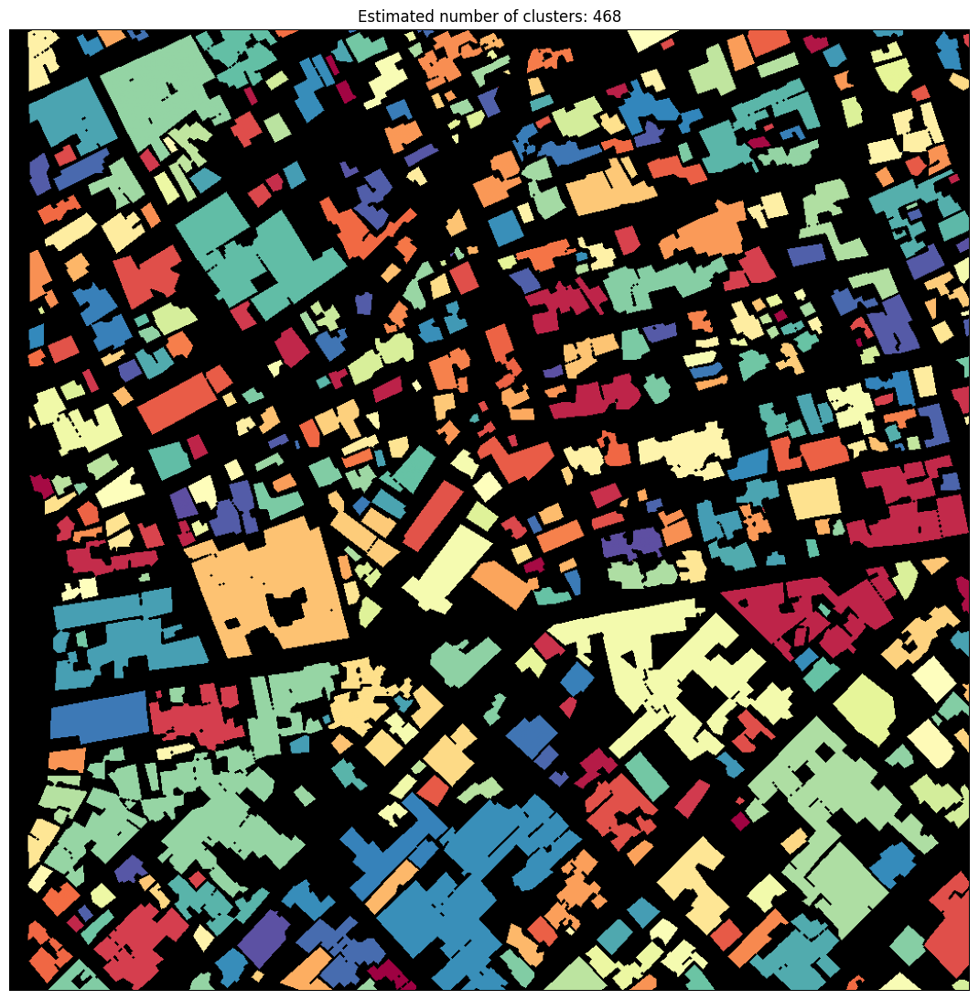

In [6]:
import random

unique_labels = set(labels)
core_samples_mask = np.zeros_like(labels, dtype=bool)
core_samples_mask[dbscan.core_sample_indices_] = True

plt.figure(figsize=(30, 30))
plt.subplot(2, 1, 1)
plt.title(f"Estimated number of clusters: {n_clusters_}")
plt.axis('off')

new_image = np.zeros(shape=(1024,1024,3))

colors = [plt.cm.Spectral(each) for each in [random.uniform(0,1) for i in range(len(unique_labels))]]

for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = labels == k

    xy = coordenadas[class_member_mask & core_samples_mask]
    for cord in xy:
        new_image[cord[0]][cord[1]] = [col[0],col[1],col[2]]
    #plt.plot(xy[:, 0],xy[:, 1], markerfacecolor=tuple(col),markeredgecolor="k",markersize=1,)
plt.imshow(new_image)
plt.show()

## DBSCAN model training

In [7]:
import random
from sklearn.cluster import DBSCAN

pair : DisasterPair = disaster_pair_dicc['mexico-earthquake_00000003']
# Cargar los targets
ground_truth = cv2.imread(os.path.join(target_dir, pair.get_pre().get_target_file_name()))
alpha = cv2.cvtColor(ground_truth,cv2.COLOR_RGB2GRAY)

# Obtener las coordenadas de los píxeles blancos
coordenadas = np.argwhere(alpha > 0)

# Inicializar y ajustar el modelo DBSCAN
dbscan = DBSCAN(eps=1, min_samples=5).fit(coordenadas)
labels = dbscan.labels_
n_1_clusters = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

labels_map_1 = np.zeros(shape=(1024,1024,3))

unique_labels = set(labels)
core_samples_mask = np.zeros_like(labels, dtype=bool)
core_samples_mask[dbscan.core_sample_indices_] = True
colors = [plt.cm.Spectral(each) for each in np.linspace(0,1,num=len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        col = [0, 0, 0, 1] # Black used for noise.
    class_member_mask = labels == k
    xy = coordenadas[class_member_mask & core_samples_mask]
    for cord in xy:
        labels_map_1[cord[0]][cord[1]] = [col[0],col[1],col[2]]

## Label connected regions array algorithm based model training
References

[1] Christophe Fiorio and Jens Gustedt, “Two linear time Union-Find strategies for image processing”, Theoretical Computer Science 154 (1996), pp. 165-181.

[2] Kensheng Wu, Ekow Otoo and Arie Shoshani, “Optimizing connected component labeling algorithms”, Paper LBNL-56864, 2005, Lawrence Berkeley National Laboratory (University of California), http://repositories.cdlib.org/lbnl/LBNL-56864


In [8]:
from skimage.measure import label

# Cargar la imagen
ground_truth = cv2.imread(os.path.join(target_dir, pair.get_pre().get_target_file_name()))
alpha = cv2.cvtColor(ground_truth,cv2.COLOR_RGB2GRAY)

labels_map_3,n_3_clusters = label(alpha,0,True,1)

## felzenszwalb algorithm based model training

In [9]:
from skimage.segmentation import felzenszwalb

# Cargar la imagen
ground_truth = cv2.imread(os.path.join(target_dir, pair.get_pre().get_target_file_name()))
alpha = cv2.cvtColor(ground_truth,cv2.COLOR_RGB2GRAY)

# Aplicar el algoritmo de Felzenszwalb
labels_map_2 = felzenszwalb(alpha, scale=100, sigma=0, min_size=10)
n_2_clusters = np.unique(labels_map_2).size

## Mask comparation

### Visualization

In [10]:
def RandomColorBuildings(labels_map):
    """
        Assings a random color for each lable mask
    """
    color_map = np.zeros(shape=(1024,1024,3))
    unique_labels = np.unique(labels_map)
    colors = [plt.cm.Spectral(each) for each in [random.uniform(0,1) for i in range(len(unique_labels))]]

    # Obtener las coordenadas de los píxeles blancos
    coordenadas = np.argwhere(labels_map > 0)

    for curr_label, color in zip(unique_labels, colors):
        if curr_label == -1:
            color = [0, 0, 0, 1] # Black used for noise.
        
        curr_class_mask = labels_map == curr_label
        
        cur_cords = coordenadas[curr_class_mask]
        for cord in cur_cords:
            color_map[cord[0]][cord[1]] = [color[0],color[1],color[2]]
    return color_map

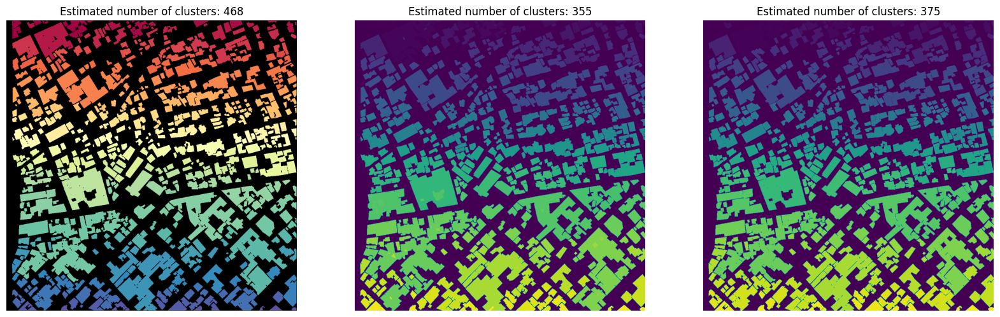

In [11]:
plt.figure(figsize=(20, 20))

#colored_map_1 = RandomColorBuildings(labels_map_1) 
plt.subplot(1, 3, 1)
plt.title(f"Estimated number of clusters: {n_1_clusters}")
plt.axis('off')
plt.imshow(labels_map_1)

#colored_map_2 = RandomColorBuildings(labels_map_2) 
plt.subplot(1, 3, 2)
plt.title(f"Estimated number of clusters: {n_2_clusters}")
plt.axis('off')
plt.imshow(labels_map_2)

#colored_map_3 = RandomColorBuildings(labels_map_3)
plt.subplot(1, 3, 3)
plt.title(f"Estimated number of clusters: {n_3_clusters}")
plt.axis('off')
plt.imshow(labels_map_3)

plt.show()

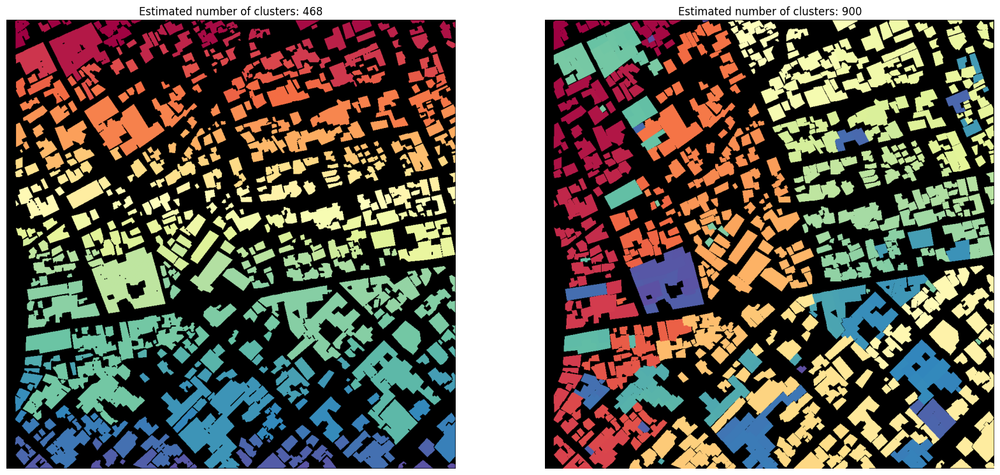

In [12]:
plt.figure(figsize=(20, 20))

plt.subplot(1, 2, 1)
plt.title(f"Estimated number of clusters: {n_1_clusters}")
plt.axis('off')
plt.imshow(labels_map_1)

colored_map_2= cv2.imread("../data/my_train/masked_targets/mexico-earthquake_00000003_pre_disaster_target.png")
plt.subplot(1, 2, 2)
plt.title(f"Estimated number of clusters: {900}")
plt.axis('off')
plt.imshow(colored_map_2)
plt.show()